<a href="https://colab.research.google.com/github/xiaofangZH/Segment-Anything-2-AGV-Test/blob/main/AGV_INFO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import zipfile
import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import time

In [ ]:
!pip install sam2

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.3/75.3 kB 2.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 3.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 6.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 7.3 MB/s eta 0:00:00
  Created wheel for sam2: filename=sam2-0.4.1-cp310-cp310-linux_x86_64.whl size=425008 sha256=85c1151a6b217460fc82e44780d4991bd870eeda7db3a70a600f981a34a9a0e5
  Stored in directory: /root/.cache/pip/wheels/f7/24/19/6ae406a45571a7fed8ef81297fc11698486638ac21200cdafa
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144555 sha25

In [ ]:
zip_path = '/content/sample_data/AGV-GOOLE.zip'
zip_ectract='/content/sample_data'
with zipfile.ZipFile(zip_path,'r') as zip_ref:
  zip_ref.extractall(zip_ectract)

In [ ]:
torch.autocast(device_type="cuda", dtype=torch.bfloat16).__enter__()

if torch.cuda.get_device_properties(0).major >= 8:
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    torch.backends.cuda.matmul.allow_tf32 = True
    torch.backends.cudnn.allow_tf32 = True

In [ ]:
from sam2.build_sam import build_sam2_video_predictor

sam2_checkpoint = "/content/sample_data/sam2_hiera_tiny.pt"
model_cfg = "sam2_hiera_t.yaml"

predictor = build_sam2_video_predictor(model_cfg, sam2_checkpoint)

/usr/local/lib/python3.10/dist-packages/sam2/modeling/sam/transformer.py:23: UserWarning: Flash Attention is disabled as it requires a GPU with Ampere (8.0) CUDA capability.
  OLD_GPU, USE_FLASH_ATTN, MATH_KERNEL_ON = get_sdpa_settings()


In [ ]:
def show_mask(mask, ax, obj_id=None, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        cmap = plt.get_cmap("tab10")
        cmap_idx = 0 if obj_id is None else obj_id
        color = np.array([*cmap(cmap_idx)[:3], 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)


def show_points(coords, labels, ax, marker_size=100):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1)

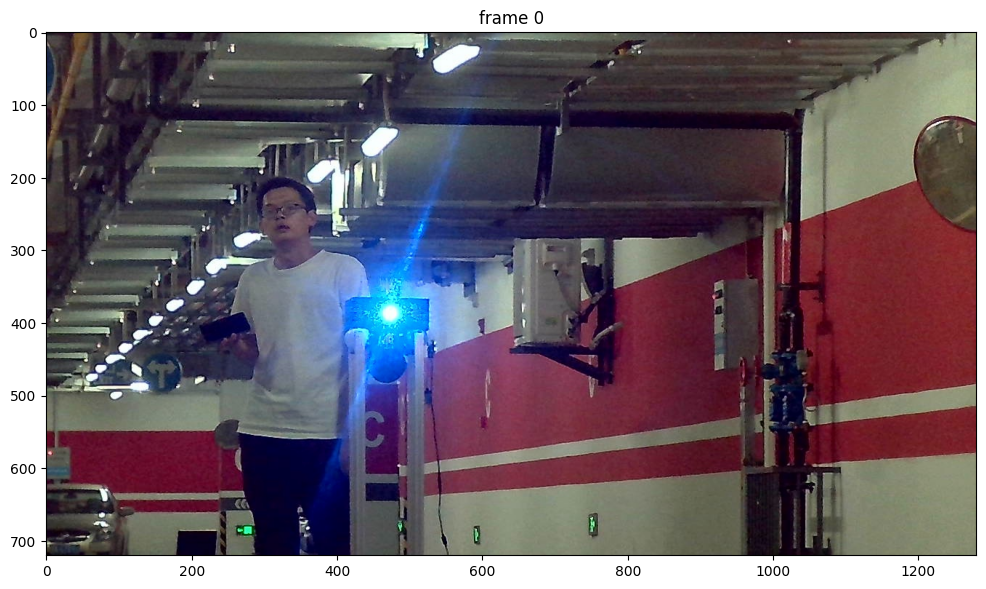

In [ ]:
import os
video_dir = "/content/sample_data/AGV-GOOLE"

# scan all the JPEG frame names in this directory
frame_names = [
    p for p in os.listdir(video_dir)
    if os.path.splitext(p)[-1] in [".jpg", ".jpeg", ".JPG", ".JPEG"]
]
frame_names.sort(key=lambda p: os.path.splitext(p)[0])

# take a look the first video frame
frame_idx = 0
plt.figure(figsize=(12, 8))
plt.title(f"frame {frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[frame_idx])))

In [ ]:
# 视频分割开始时间
start_time = time.time()
inference_state = predictor.init_state(video_path=video_dir)

frame loading (JPEG): 100%|██████████| 452/452 [00:20<00:00, 22.14it/s]


In [ ]:
predictor.reset_state(inference_state)

Time to add points and get mask: 1.0107958316802979 seconds


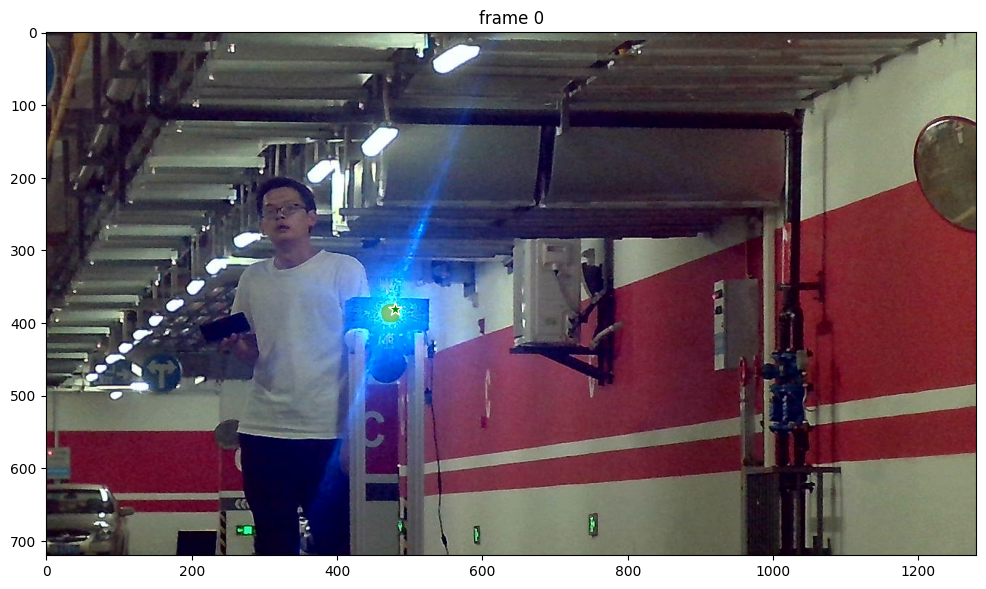

In [ ]:
ann_frame_idx = 0  # the frame index we interact with
ann_obj_id = 2  # give a unique id to each object we interact with (it can be any integers)

# Let's add a positive click at (x, y) = (210, 350) to get started
points = np.array([[480, 380]], dtype=np.float32)
# for labels, `1` means positive click and `0` means negative click
labels = np.array([1], np.int32)
# 添加新点并获取掩码的延迟时间
start_add_points = time.time()
_, out_obj_ids, out_mask_logits = predictor.add_new_points(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
)

end_add_points = time.time()
print(f"Time to add points and get mask: {end_add_points - start_add_points} seconds")

plt.figure(figsize=(12, 8))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_points(points, labels, plt.gca())
show_mask((out_mask_logits[0] > 0.0).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])
# bool_mask = (out_mask_logits[0] > 0.0).cpu().numpy()
# true_indices = np.where(bool_mask)
# for i in range(len(true_indices[0])):
#     print(f"Index of True element: ({true_indices[2][i]}, {true_indices[1][i]})")

propagate in video: 100%|██████████| 452/452 [03:19<00:00,  2.26it/s]


Time to propagate in video: 199.6961658000946 seconds
Average frame processing time: 0.007306937622812997 seconds
Frame rate: 136.85623877202661 fps


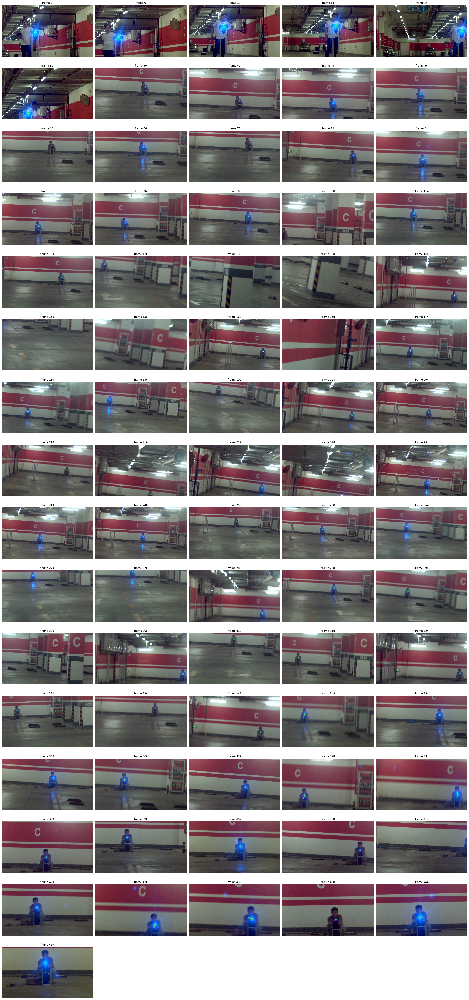

In [ ]:
# 初始化变量以记录总时间和帧数
total_frame_processing_time = 0
frame_count = 0
# 推理视频并分割的延迟时间
start_propagate = time.time()
video_segments = {}
for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    start_frame_time = time.time()
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }
    end_frame_time = time.time()
    frame_processing_time = end_frame_time - start_frame_time  # 计算处理当前帧所需的时间
    total_frame_processing_time += frame_processing_time  # 累加处理时间
    frame_count += 1  # 帧数加一
end_propagate = time.time()
print(f"Time to propagate in video: {end_propagate - start_propagate} seconds")
# 计算平均每帧处理时间
average_frame_processing_time = total_frame_processing_time / frame_count if frame_count > 0 else 0

# 计算帧率
frame_rate = 1 / average_frame_processing_time if average_frame_processing_time > 0 else 0
print(f"Average frame processing time: {average_frame_processing_time} seconds")
print(f"Frame rate: {frame_rate} fps")

vis_frame_stride = 6
plt.close("all")

# 每行显示的图片数量
images_per_row = 5
num_frames = len(frame_names)
num_rows = (num_frames + images_per_row - 1) // images_per_row

fig, axes = plt.subplots(num_rows, images_per_row, figsize=(images_per_row * 6, num_rows * 4))

for idx, out_frame_idx in enumerate(range(0, num_frames, vis_frame_stride)):
    row = idx // images_per_row
    col = idx % images_per_row
    ax = axes[row, col] if num_rows > 1 else axes[col]
    ax.set_title(f"frame {out_frame_idx}")
    ax.imshow(Image.open(os.path.join(video_dir, frame_names[out_frame_idx])))
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask(out_mask, ax, obj_id=out_obj_id)
    ax.axis('off')

# 隐藏多余的子图
for idx in range(len(range(0, num_frames, vis_frame_stride)), num_rows * images_per_row):
    row = idx // images_per_row
    col = idx % images_per_row
    fig.delaxes(axes[row, col] if num_rows > 1 else axes[col])

plt.tight_layout()
plt.show()